In [290]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [320]:
files = os.listdir(data_path)
files

['rb_20150618.csv.gz',
 'rb_20140902.csv.gz',
 'rb_20180207.csv.gz',
 'rb_20180411.csv.gz',
 'rb_20180711.csv.gz',
 'rb_20150423.csv.gz',
 'rb_20160128.csv.gz',
 'rb_20170808.csv.gz',
 'rb_20160330.csv.gz',
 'rb_20151109.csv.gz',
 'rb_20160203.csv.gz',
 'rb_20180607.csv.gz',
 'rb_20170728.csv.gz',
 'rb_20180904.csv.gz',
 'rb_20161219.csv.gz',
 'rb_20150506.csv.gz',
 'rb_20181114.csv.gz',
 'rb_20160310.csv.gz',
 'rb_20140103.csv.gz',
 'rb_20170629.csv.gz',
 'rb_20180111.csv.gz',
 'rb_20160331.csv.gz',
 'rb_20181017.csv.gz',
 'rb_20150512.csv.gz',
 'rb_20140613.csv.gz',
 'rb_20150702.csv.gz',
 'rb_20160118.csv.gz',
 'rb_20160503.csv.gz',
 'rb_20151125.csv.gz',
 'rb_20150427.csv.gz',
 'rb_20150514.csv.gz',
 'rb_20150928.csv.gz',
 'rb_20160615.csv.gz',
 'rb_20181203.csv.gz',
 'rb_20140520.csv.gz',
 'rb_20171012.csv.gz',
 'rb_20161129.csv.gz',
 'rb_20180117.csv.gz',
 'rb_20140224.csv.gz',
 'rb_20170926.csv.gz',
 'rb_20180808.csv.gz',
 'rb_20140424.csv.gz',
 'rb_20171114.csv.gz',
 'rb_201608

In [316]:
data_path = '/mnt/data/data/main/min/rb'
files = os.listdir(data_path)
data_list = [pd.read_csv(f"{data_path}/{file}", compression='gzip') for file in files]
data_list

[                datetime    open    high     low   close  symbol  prev_settle  \
 0    2015-06-17 21:00:00  2226.0  2229.0  2225.0  2228.0  rb1510       2231.0   
 1    2015-06-17 21:01:00  2228.0  2229.0  2226.0  2226.0  rb1510       2231.0   
 2    2015-06-17 21:02:00  2226.0  2229.0  2225.0  2229.0  rb1510       2231.0   
 3    2015-06-17 21:03:00  2229.0  2234.0  2229.0  2232.0  rb1510       2231.0   
 4    2015-06-17 21:04:00  2232.0  2232.0  2230.0  2231.0  rb1510       2231.0   
 5    2015-06-17 21:05:00  2232.0  2232.0  2230.0  2230.0  rb1510       2231.0   
 6    2015-06-17 21:06:00  2230.0  2231.0  2229.0  2230.0  rb1510       2231.0   
 7    2015-06-17 21:07:00  2230.0  2230.0  2229.0  2229.0  rb1510       2231.0   
 8    2015-06-17 21:08:00  2229.0  2231.0  2229.0  2231.0  rb1510       2231.0   
 9    2015-06-17 21:09:00  2230.0  2232.0  2230.0  2232.0  rb1510       2231.0   
 10   2015-06-17 21:10:00  2232.0  2233.0  2231.0  2233.0  rb1510       2231.0   
 11   2015-06-17

In [319]:
df = pd.concat(data_list).set_index('datetime').sort_index()

Train develop set split

In [338]:
tickers = sorted(set(df.symbol))
num_tickers = len(tickers)
train_dev_split = int(0.75*num_tickers)
train_tickers = tickers[:train_dev_split]
dev_tickers = tickers[train_dev_split:]
train_tickers
dev_tickers

['rb1805', 'rb1810', 'rb1901', 'rb1905']

In [341]:
60 * 6 * 252 * 5 

453600

In [326]:
for ticker in train_tickers:
    row_indicator = df.symbol == ticker
    df.loc[row_indicator,'next_rtn'] = df.loc[row_indicator, 'close'].shift(-1) / df.loc[row_indicator, 'close'] - 1 # note return is the y 
    df.loc[row_indicator,'next_vw_rtn'] = df.loc[row_indicator,'close_vwp'].shift(-1) / df.loc[row_indicator,'close_vwp'] - 1
    df.loc[row_indicator,'rtn'] = df.loc[row_indicator, 'close'].pct_change()
    df.loc[row_indicator,'next_log_rtn'] = np.log(df.loc[row_indicator,'close'].shift(-1)) - np.log(df.loc[row_indicator,'close']) 
    df.loc[row_indicator,'bar_volume'] = df.loc[row_indicator,'volume'] - df.loc[row_indicator,'volume'].shift().fillna(0)
    df.loc[row_indicator & df.bar_volume < 0, 'bar_volume'] = df.loc[row_indicator & df.bar_volume < 0, 'volume']
    df.loc[row_indicator,'bar_volume'] = df.loc[row_indicator,'bar_volume'] / 2
    df.loc[row_indicator,'bar_turnover'] = df.loc[row_indicator,'turnover'] - df.loc[row_indicator,'turnover'].shift().fillna(0)
    df.loc[row_indicator & df.bar_turnover < 0, 'bar_turnover'] = df.loc[row_indicator & df.bar_turnover < 0, 'turnover']
    df.loc[row_indicator,'prev_bar_volume'] = df.loc[row_indicator, 'bar_volume'].shift()
    df.loc[row_indicator,'mean_rtn_of_prev_5_bar'] = df.loc[row_indicator, 'rtn'].rolling(5, win_type=None).mean()
    df.loc[row_indicator,'mean_rtn_of_prev_20_bar'] = df.loc[row_indicator, 'rtn'].rolling(20, win_type=None).mean()
    df.loc[row_indicator,'mean_rtn_of_prev_60_bar'] = df.loc[row_indicator, 'rtn'].rolling(60, win_type=None).mean()
    df.loc[row_indicator,'mean_volume_of_prev_5_bar'] = df.loc[row_indicator, 'bar_volume'].rolling(5, win_type=None).mean()
    df.loc[row_indicator,'mean_volume_of_prev_20_bar'] = df.loc[row_indicator, 'bar_volume'].rolling(20, win_type=None).mean()
    df.loc[row_indicator,'mean_openinterest_of_prev_5_bar'] = df.loc[row_indicator, 'open_interest'].rolling(5, win_type=None).mean()
    df.loc[row_indicator,'mean_openinterest_of_prev_20_bar'] = df.loc[row_indicator, 'open_interest'].rolling(20, win_type=None).mean()
    df.loc[row_indicator,'prev_bar_turnover'] = df.loc[row_indicator,'bar_turnover'].shift()
    df.loc[row_indicator,'mean_turnover_of_prev_5_bar'] = df.loc[row_indicator,'bar_turnover'].rolling(5, win_type=None).mean()
    df.loc[row_indicator,'mean_turnover_of_prev_20_bar'] = df.loc[row_indicator,'bar_turnover'].rolling(20, win_type=None).mean()
    df.loc[row_indicator,'prev_rtn'] = df.loc[row_indicator, 'rtn'].shift()


In [327]:
df.rename(columns=feature_dict)
df.columns

Index(['open', 'high', 'low', 'close', 'symbol', 'prev_settle', 'prev_close',
       'prev_open_interest', 'day_open', 'day_high', 'day_low', 'volume',
       'turnover', 'open_interest', 'limit_up', 'limit_down',
       'open_bid_price1', 'open_bid_volume1', 'close_bid_price1',
       'close_bid_volume1', 'open_ask_price1', 'open_ask_volume1',
       'close_ask_price1', 'close_ask_volume1', 'high_bid_price1',
       'high_ask_price1', 'low_bid_price1', 'low_ask_price1', 'open_vwp',
       'close_vwp', '1', '2', '4', '18', '3', '13', '8', '5', '6', '7', '9',
       '10', '11', '12', '14', '16', '17', '15', 'next_rtn', 'next_vw_rtn',
       'rtn', 'next_log_rtn', 'bar_volume', 'bar_turnover', 'prev_bar_volume',
       'mean_rtn_of_prev_5_bar', 'mean_rtn_of_prev_20_bar',
       'mean_rtn_of_prev_60_bar', 'mean_volume_of_prev_5_bar',
       'mean_volume_of_prev_20_bar', 'mean_openinterest_of_prev_5_bar',
       'mean_openinterest_of_prev_20_bar', 'prev_bar_turnover',
       'mean_turnover

In [328]:
df[['rtn','next_rtn']].corr()

,rtn,next_rtn
rtn,1.000000,-0.094012
next_rtn,-0.094012,1.000000


Use close and close_vwp to calculate minute return

In [253]:
feature_dict = {
    'next_rtn':'1', # watch look ahead bias
    'next_vw_rtn':'2', # watch look ahead bias
    'bar_volume':'3',
    'rtn':'4',
    'mean_rtn_of_prev_5_bar':'5', 
    'mean_rtn_of_prev_20_bar':'6',
    'mean_rtn_of_prev_60_bar':'7', 
    'prev_bar_volume':'8',
    'mean_volume_of_prev_5_bar':'9', 
    'mean_volume_of_prev_20_bar':'10',
    'mean_openinterest_of_prev_5_bar':'11',
    'mean_openinterest_of_prev_20_bar':'12',
    'bar_turnover':'13',
    'prev_bar_turnover':'14',
    'prev_rtn': '15',
    'mean_turnover_of_prev_5_bar':'16',
    'mean_turnover_of_prev_20_bar':'17',
    'next_log_rtn':'18'
}
selected_columns = feature_dict.values()

In [129]:
from sklearn.decomposition import PCA

In [335]:
features = ['4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17']
feature_names = dict()
for k, v in feature_dict.items():
    if v in features:
        feature_names[v] = k
predict_col = "1"
predict_col2 = "2"
mean_score_list = list()
mean_score_list2 = list()
for x in features:
    score_list = list()
    score_list2 = list()
    all_cols = [x, predict_col, predict_col2]
    for ticker in train_tickers:
        row_indicator = df.symbol == ticker
        data = df.loc[row_indicator,all_cols].dropna()
        X = data[x].values
        Y1 = data[predict_col].values # close return
        Y2 = data[predict_col2].values # log return
        score_list.append(np.corrcoef(X,Y1)[0,1])
        score_list2.append(np.corrcoef(X,Y2)[0,1]) 
    mean_score_list.append(np.mean(score_list))
    mean_score_list2.append(np.mean(score_list2))
    

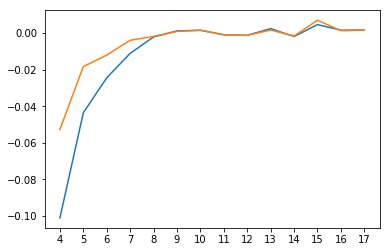

In [336]:
feature_names

plt.plot(features, mean_score_list)
plt.plot(features, mean_score_list2)

[0.0005321327663836417, 8.603326197564874e-06, 0.00011066724527863947, 1.454417564583643e-05, 6.645004062444393e-05, 1.6701448751765824e-06, 9.836344291203059e-05, 1.2623872626016386e-05, 1.0815160563004689e-05, 1.763740800464486e-05, 9.328437107214427e-07, 4.926122272808087e-05]


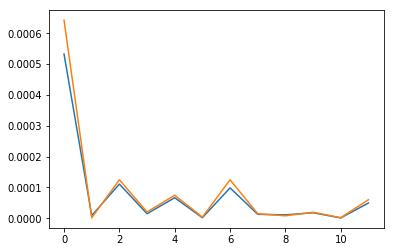

In [315]:
import matplotlib.pyplot as plt
print(score_list)
plt.plot(score_list)
plt.plot(score_list2)
plt.show()

In [114]:

X.shape

(290483, 14)

In [97]:

Y2 = data[:,1] # close vwp return
Y1.shape

(290483,)

In [99]:
from sklearn.linear_model import LinearRegression

In [116]:
reg2 = LinearRegression().fit(X,Y2)

In [117]:
print(reg.score(X,Y1), reg2.score(X,Y2))

0.009070107377106895 0.003553364436843065


In [119]:
reg.coef_

array([ 9.68458234e-12, -1.00303406e-01,  3.60504240e-02, -2.34727854e-02,
       -1.07255987e-10, -5.32977944e-10, -2.13972279e-10,  1.85524319e-10,
       -1.83208534e-10, -2.15851181e-16,  2.48179679e-15, -5.67580008e-03,
        9.44809626e-15,  3.53713024e-15])

In [118]:
reg2.coef_

array([-3.28851277e-11, -6.27276648e-02,  3.62733517e-02, -2.62810081e-02,
       -1.07940972e-10, -5.14487253e-10, -1.95677069e-10,  1.94575281e-10,
       -1.92345966e-10,  4.75846137e-16,  2.44352866e-15, -1.87515022e-03,
        9.21709486e-15,  3.29014857e-15])